In [1]:
import os
import sys
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer


sys.path.append(os.path.abspath('..'))

from dataframe_generator import *
from image_patching import *

In [2]:
df, split_variables = create_dataframe()
df

                             image_path category
0        ../data/CBIR_15-Scene/00/1.jpg  Bedroom
1        ../data/CBIR_15-Scene/00/2.jpg  Bedroom
2        ../data/CBIR_15-Scene/00/3.jpg  Bedroom
3        ../data/CBIR_15-Scene/00/4.jpg  Bedroom
4        ../data/CBIR_15-Scene/00/5.jpg  Bedroom
...                                 ...      ...
4480  ../data/CBIR_15-Scene/14/4481.jpg    Store
4481  ../data/CBIR_15-Scene/14/4482.jpg    Store
4482  ../data/CBIR_15-Scene/14/4483.jpg    Store
4483  ../data/CBIR_15-Scene/14/4484.jpg    Store
4484  ../data/CBIR_15-Scene/14/4485.jpg    Store

[4485 rows x 2 columns]


,image_path,category
0,../data/CBIR_15-Scene/00/1.jpg,Bedroom
1,../data/CBIR_15-Scene/00/2.jpg,Bedroom
2,../data/CBIR_15-Scene/00/3.jpg,Bedroom
3,../data/CBIR_15-Scene/00/4.jpg,Bedroom
4,../data/CBIR_15-Scene/00/5.jpg,Bedroom
...,...,...
4480,../data/CBIR_15-Scene/14/4481.jpg,Store
4481,../data/CBIR_15-Scene/14/4482.jpg,Store
4482,../data/CBIR_15-Scene/14/4483.jpg,Store
4483,../data/CBIR_15-Scene/14/4484.jpg,Store


# Now we are going to work with 2 similar environments

In [3]:
X = df['image_path']
y = df['category']
(X_train, X_test, y_train, y_test) = train_test_split(X, y, test_size=0.2, random_state=10)


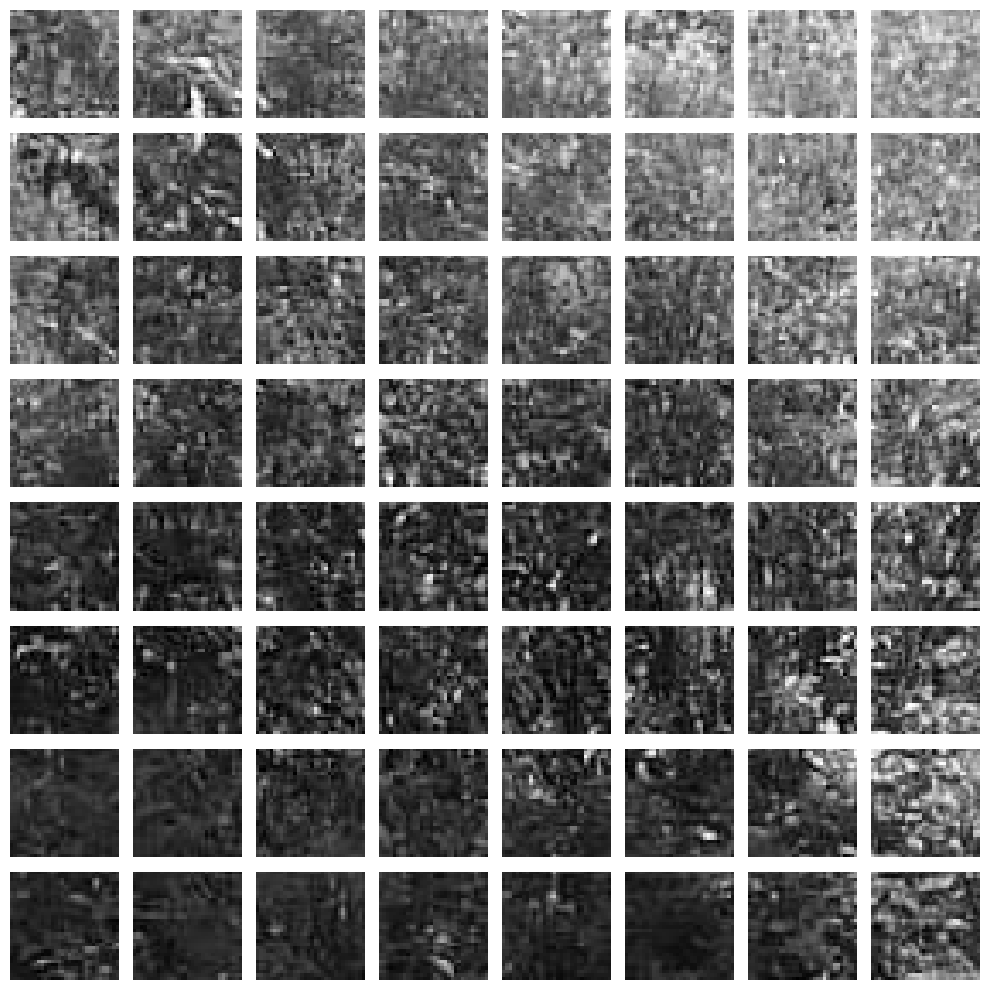

In [4]:
# Função para criar a grid de patches
def plot_patches_grid(patches, patch_size, grid_shape):
    fig, axes = plt.subplots(grid_shape[0], grid_shape[1], figsize=(10, 10))
    patch_idx = 0
    for i in range(grid_shape[0]):
        for j in range(grid_shape[1]):
            if patch_idx < len(patches):
                axes[i, j].imshow(cv2.cvtColor(patches[patch_idx], cv2.COLOR_BGR2RGB))
                axes[i, j].axis('off')
                patch_idx += 1
            else:
                axes[i, j].axis('off')
    plt.tight_layout()
    plt.show()

patch_size = (32,32)

# Carregar a primeira imagem de treino e criar os patches
first_image_path = X_train.iloc[0]
image = cv2.imread(first_image_path)
resized_image = resize_image(image, standard_size)
patches, positions = create_patches(resized_image, patch_size)

# Determinar o número de patches na grid
grid_rows = resized_image.shape[0] // patch_size[0]
grid_cols = resized_image.shape[1] // patch_size[1]

# Plotar a grid de patches
plot_patches_grid(patches, patch_size, (grid_rows, grid_cols))


In [5]:
create_images_set(X_train, X_test, y_train, y_test, patch_size, output_dir_train='patches_train', output_dir_test='patches_test')

In [6]:
patches_by_category = load_patches_by_category('patches_train', y, patch_size)


In [7]:
from sklearn.preprocessing import StandardScaler

def normalize_patches(patches, scaler=None):
    if scaler is None:
        scaler = StandardScaler()
        normalized_patches = scaler.fit_transform(patches)
    else:
        normalized_patches = scaler.transform(patches)
    return normalized_patches, scaler


normalized_patches_by_category = {}
scalers_by_category = {}
for category, patches in patches_by_category.items():
    normalized_patches, scaler = normalize_patches(patches)
    normalized_patches_by_category[category] = normalized_patches
    scalers_by_category[category] = scaler    

In [8]:
from sklearn.decomposition import PCA
# Aplicar PCA para cada categoria e visualizar componentes
def apply_pca_and_visualize(patches_by_category, n_components=1024):
    pca_by_category = {}
    num_components_95_dict = {}
    for category, patches in patches_by_category.items():
        print(patches)
        if patches.size == 0:
            continue  # Pular se não houver patches para esta categoria
        
        #patches = impute_nans(patches)

        # Normalizar patches
        #patches = normalize_patches(patches)
        
        pca = PCA(n_components=n_components)
        pca.fit(patches)
        components = pca.components_
        variance = pca.explained_variance_
        
        # Plotar os 320 primeiros componentes principais
        fig, axes = plt.subplots(16, 20, figsize=(20, 16))
        for i, ax in enumerate(axes.flatten()):
            ax.imshow(components[i].reshape(32, 32), cmap='gray')
            ax.axis('off')
        plt.suptitle(f'{n_components} Principal Components  - Category: {category}')
        plt.show()
        
        # Plotar a log-variância dos componentes principais
        plt.figure(figsize=(10, 6))
        plt.plot(np.log(variance))
        plt.title(f'Log-Variance of Principal Components - Category: {category}')
        plt.xlabel('Index of the Principal Component')
        plt.ylabel('Log-Variance')
        plt.grid(True)
        plt.show()

        cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
        num_components_95 = np.where(cumulative_variance >= 0.95)[0][0] + 1

        #We take the PCA with the minimum significant components
        pca = PCA(n_components=num_components_95)
        pca.fit(patches)

        pca_by_category[category] = pca
        num_components_95_dict[category] = num_components_95

        print("Category: " + category)
        print("Number of components that explain 95% of variance: " + str(num_components_95))

    
    min_num_components = min(num_components_95_dict.values())
    return pca_by_category,num_components_95_dict, min_num_components

[[-0.03634141 -0.1805135  -0.41152455 ...  0.57496341  0.55540507
   0.53773585]
 [ 1.88668565  1.81823632  1.89040735 ...  0.25410052  0.20461656
   0.1290737 ]
 [-1.34962819 -1.43956851 -1.59402381 ... -1.44188905 -1.47306761
  -1.47530363]
 ...
 [ 0.54213014  0.55918132  0.55024152 ...  0.05547111  0.03684814
   0.02312426]
 [ 1.82414818  1.58216351  0.6290748  ... -0.63209223 -0.5884705
  -0.44608043]
 [ 0.8860862   0.0712975  -0.14349138 ... -0.35706689 -0.39019874
  -0.41580916]]


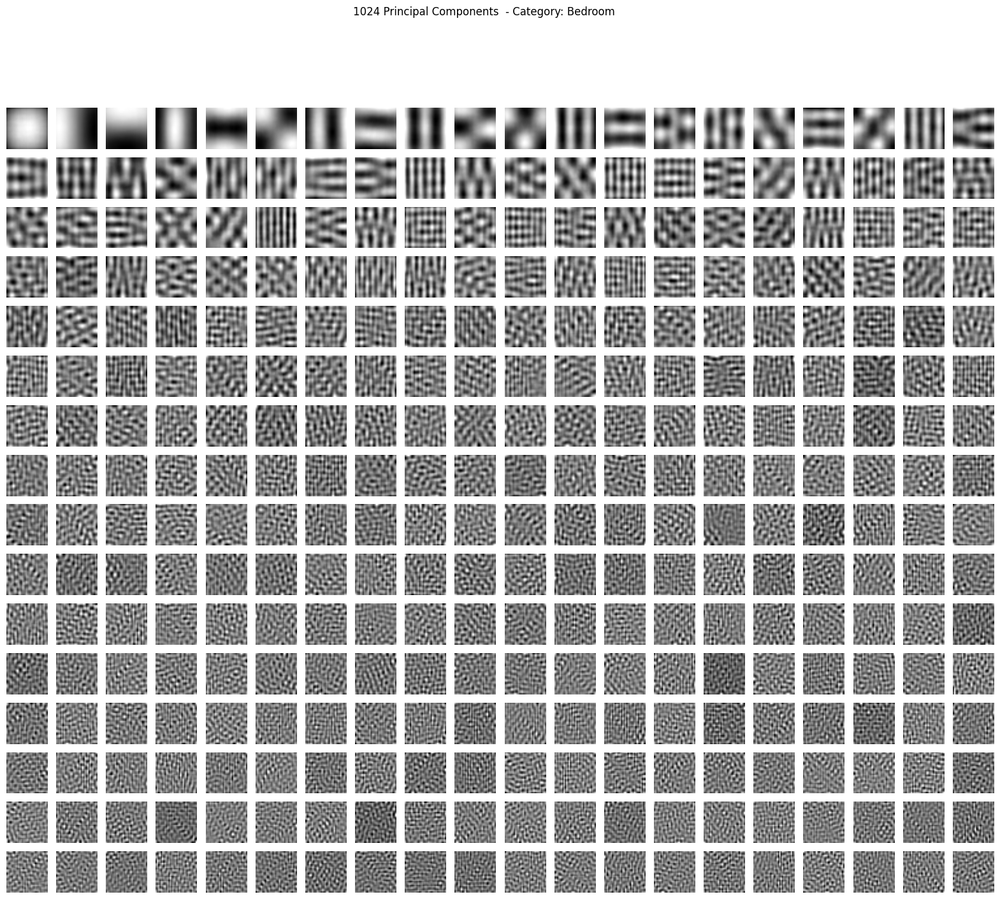

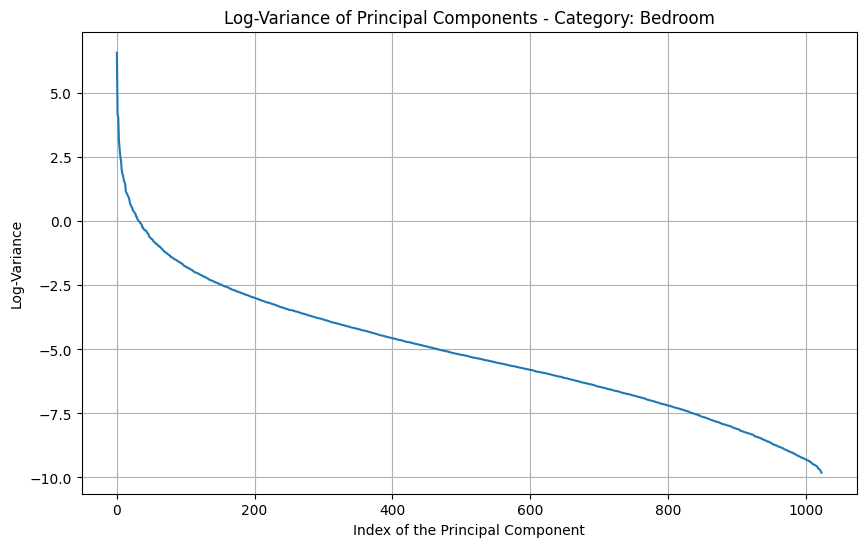

Category: Bedroom
Number of components that explain 95% of variance: 27
[[-0.47648054 -0.11061085 -0.16513569 ... -0.7479306  -0.71764425
  -0.68868807]
 [ 1.68610255  1.68881146  1.68560162 ...  1.76050345  1.76042483
   1.765118  ]
 [-0.73169221 -0.66118036 -0.63452559 ... -1.26317652 -1.29992278
  -1.31230729]
 ...
 [-1.21525116 -1.1714643  -1.06368206 ... -1.20894011 -1.13742645
  -0.81070053]
 [ 0.32945105  0.41310162  0.55906587 ... -0.53098496 -0.32494478
  -0.56667562]
 [ 0.15483254  0.06395997  0.00920913 ...  1.31305305  1.35418399
   1.42619451]]


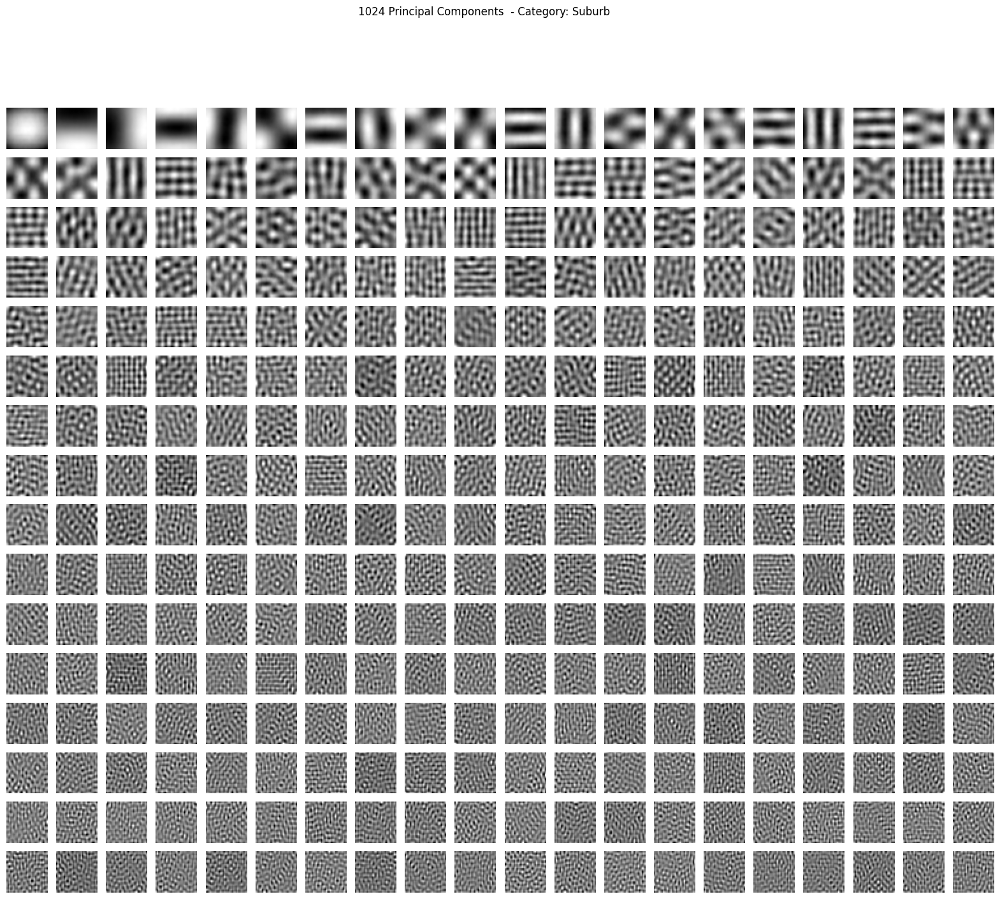

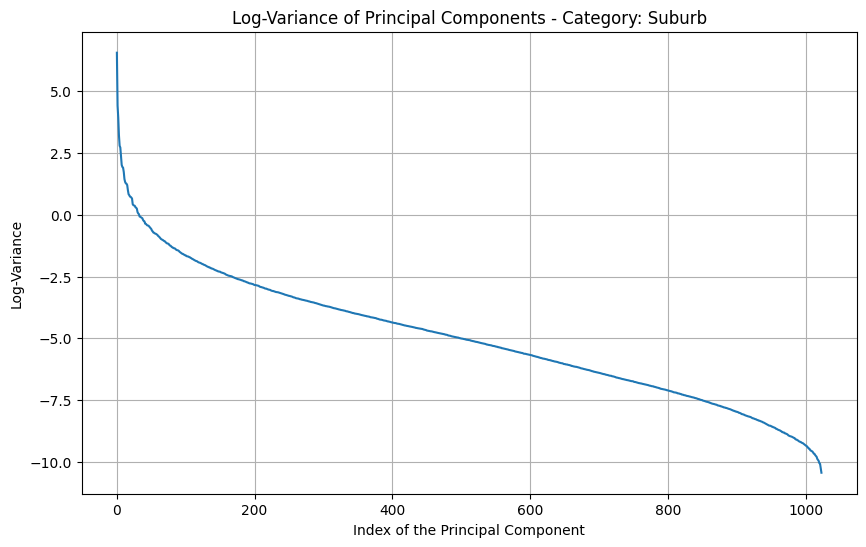

Category: Suburb
Number of components that explain 95% of variance: 30
[[ 1.66085492  1.65962569  1.66163684 ... -1.10612307 -0.08705788
   1.82027276]
 [ 1.63359604  1.64597974  1.66163684 ... -1.23333498  0.4778776
  -0.21197344]
 [-0.45170859 -0.34632985 -0.36287724 ... -0.72448736 -0.66611675
  -0.60713243]
 ...
 [-0.19274919 -0.18257837 -0.15769    ... -1.20506567 -1.21692884
  -1.28454783]
 [-1.09229236 -1.19237912 -0.96475981 ... -1.1626617  -1.24517561
  -1.34099911]
 [-0.36993194 -0.41455963 -0.54070618 ... -0.96477651 -1.30166916
  -1.04462988]]


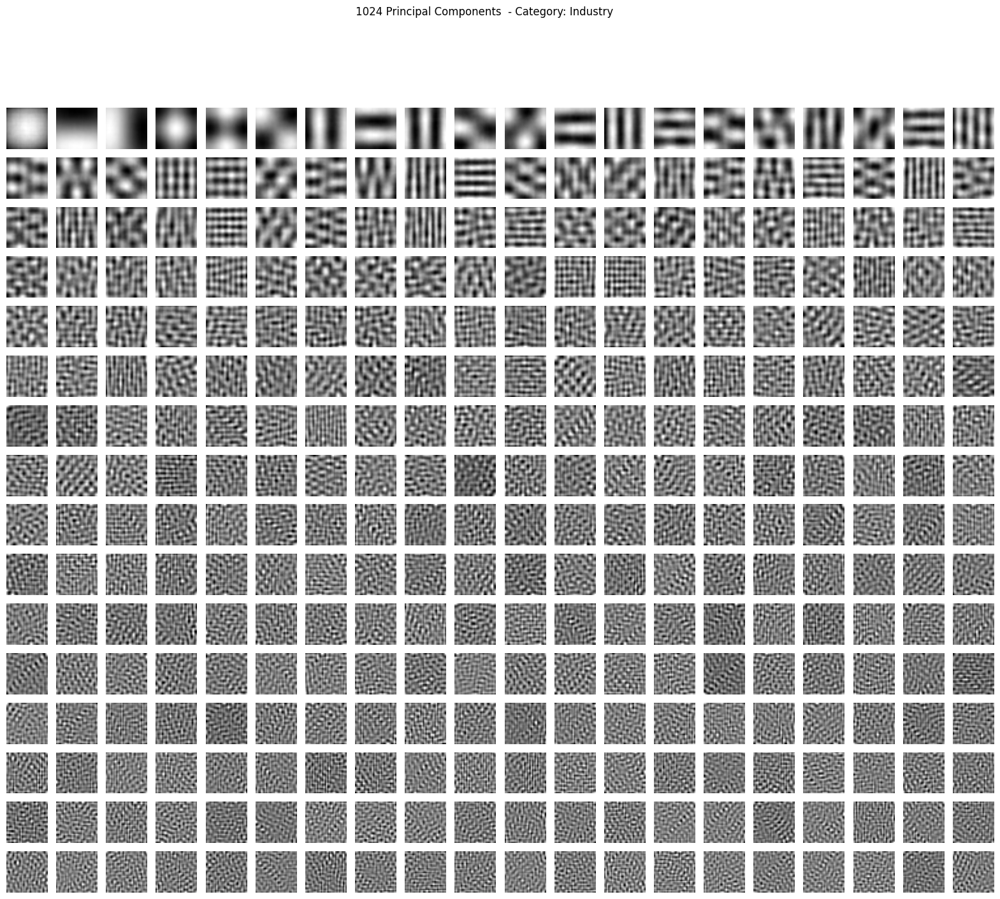

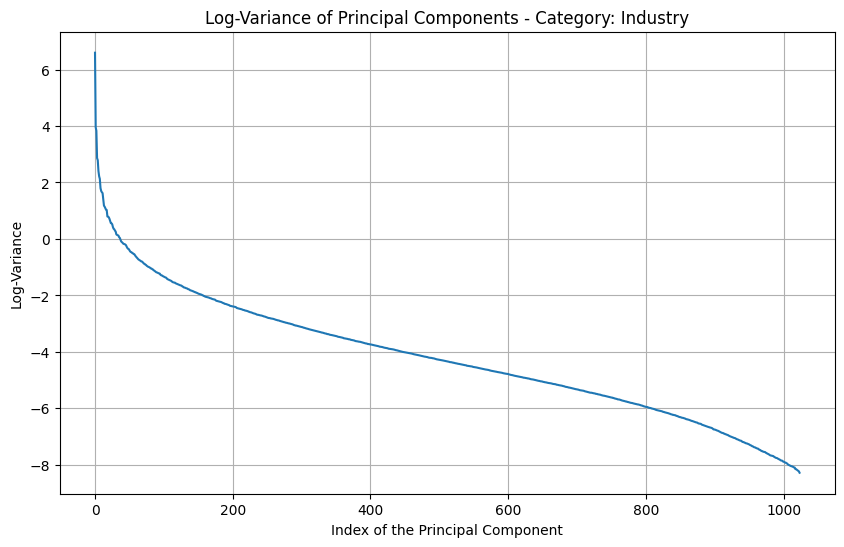

Category: Industry
Number of components that explain 95% of variance: 49
[[-0.48719487 -0.55723651 -0.52498073 ... -0.72847569 -0.71072257
  -0.65977665]
 [ 0.14903997  0.14694709  0.12965477 ...  0.31420346  0.279528
   0.4263914 ]
 [-0.2025635  -0.18837843 -0.20605575 ... -0.10623168 -0.10650188
  -0.09162721]
 ...
 [-0.78856927 -0.79196438 -0.84390572 ... -1.09845861 -1.18067198
  -1.17779526]
 [-0.10210536  0.14694709 -0.03820049 ... -1.28345007 -1.58348577
  -1.5955522 ]
 [-1.12342972 -1.14405618 -1.12925966 ... -1.38435451 -1.4324306
  -1.4451597 ]]


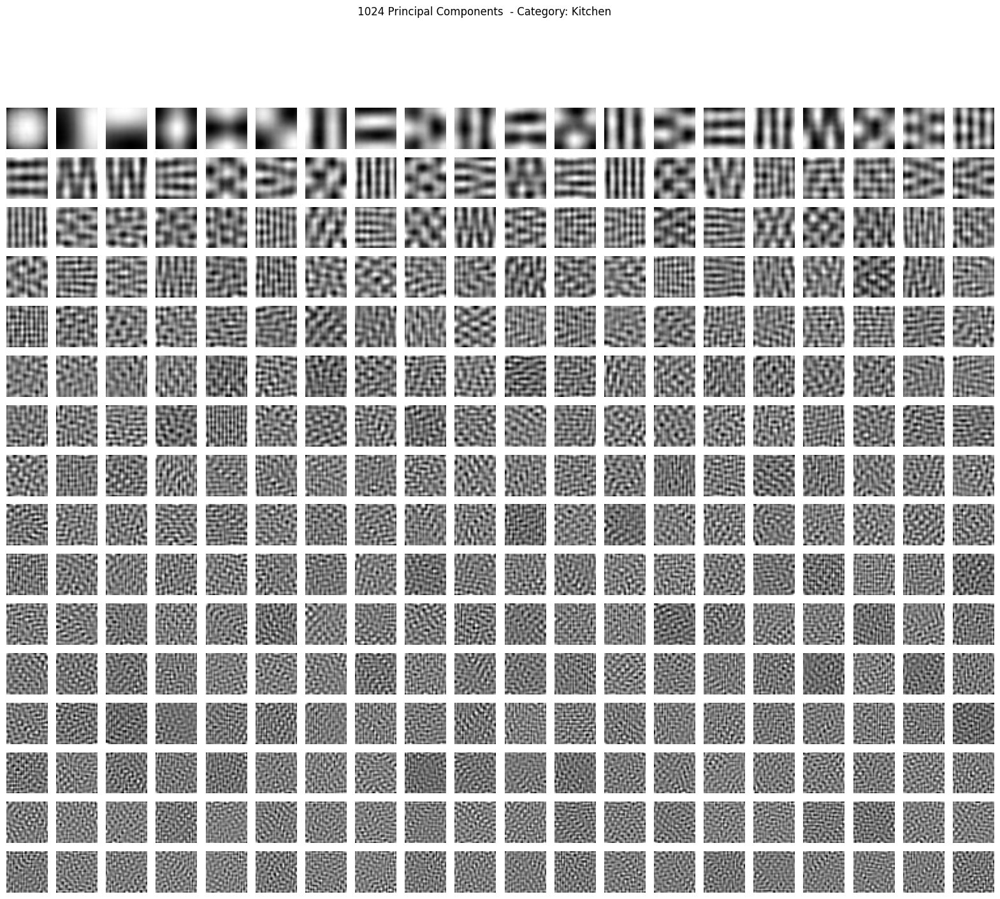

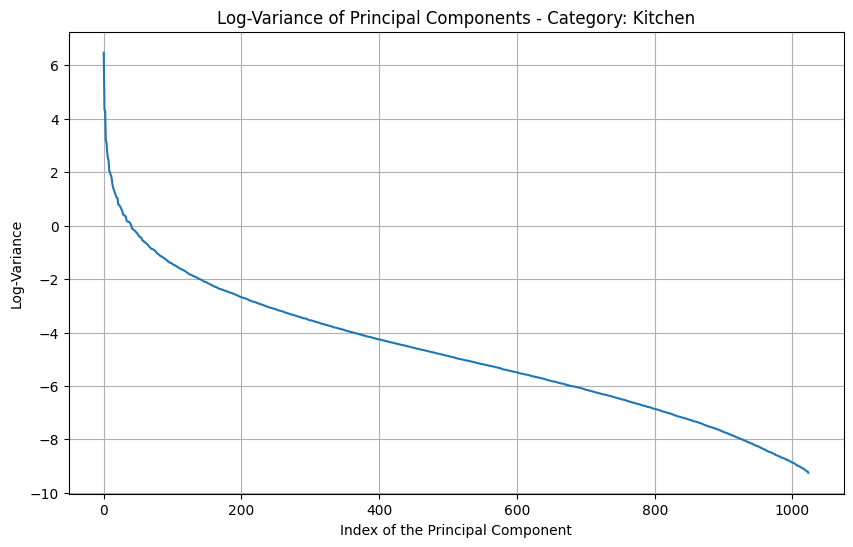

Category: Kitchen
Number of components that explain 95% of variance: 40
[[ 0.1110469   0.00628361 -0.03771406 ...  0.11729797  0.2196569
   1.47752948]
 [-0.40059599 -0.12975044 -0.47642005 ... -0.89360887 -0.94016907
  -0.80397502]
 [ 0.6226898   0.65622407  0.62790882 ... -0.35043504 -0.78954232
   1.43249978]
 ...
 [-0.43069263 -0.764576   -0.7789759  ...  0.01168084 -0.00628322
   0.03657927]
 [-1.19815697 -1.21802283 -1.21768189 ...  2.01840636  1.98198988
   1.97285611]
 [ 0.21638515  0.00628361 -0.14360861 ...  0.58503099  0.47572238
   0.5919455 ]]


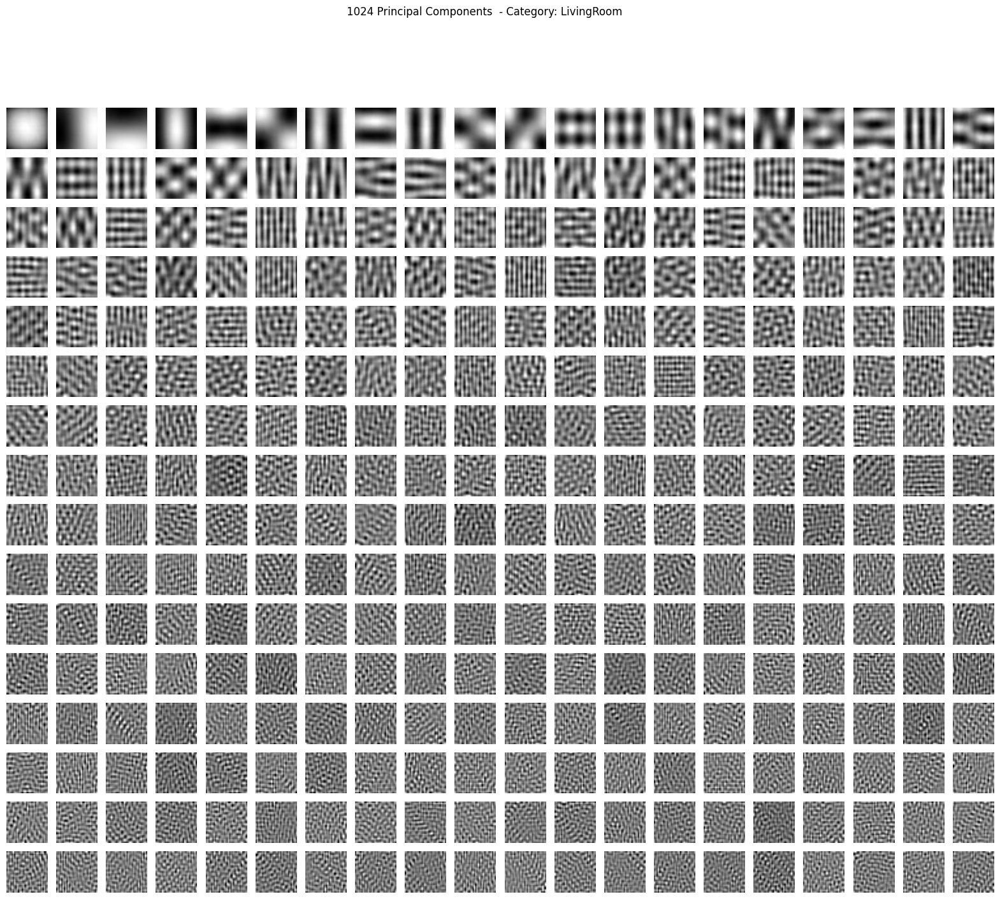

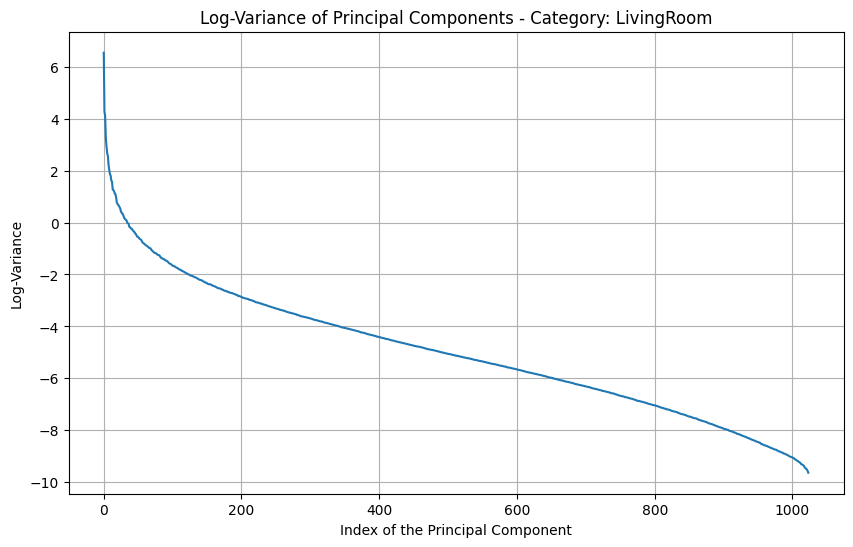

Category: LivingRoom
Number of components that explain 95% of variance: 31
[[-0.73905927 -0.71021048 -0.67763111 ... -1.59651761 -1.61066989
  -1.80472248]
 [-1.78770774 -1.49156884 -1.39122492 ... -0.33059117 -0.37872635
  -0.26116556]
 [ 0.37724393  0.3768968   0.35877895 ...  0.2690582  -0.02912076
   0.40272988]
 ...
 [-1.87227617 -1.86526197 -1.8499638  ...  2.25123249  2.25163958
   2.24503975]
 [-1.85536248 -1.86526197 -1.86695412 ...  1.60161234  1.58572415
   1.58114431]
 [-0.89128244 -1.10088966 -1.17035064 ... -1.29669292 -0.66174041
  -0.89186624]]


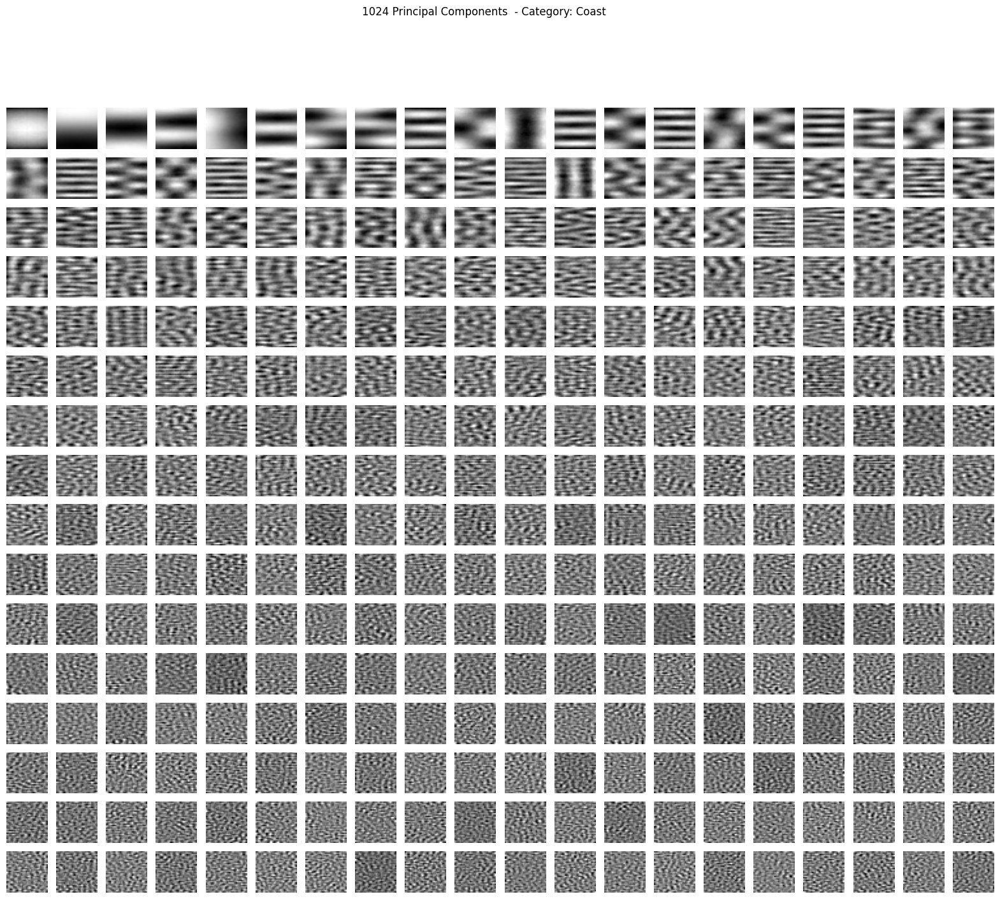

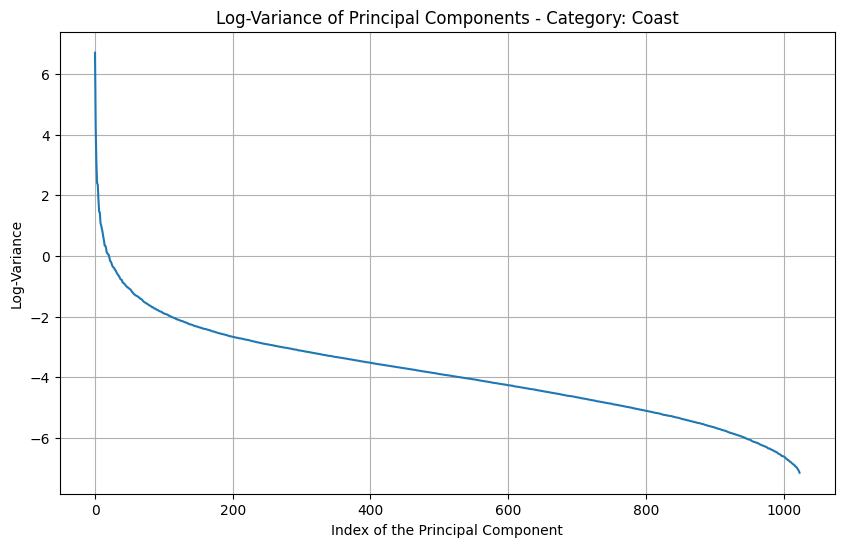

Category: Coast
Number of components that explain 95% of variance: 23
[[ 0.12444129 -0.32899402  0.52171967 ...  0.77645902  0.62862044
   0.99785019]
 [-1.12840223 -1.18768381 -1.1150633  ...  1.73907215  1.32464762
   1.11236043]
 [ 1.34474343  1.55040251  1.23477364 ...  1.22457203  1.58980084
   1.71762883]
 ...
 [-1.20975571 -1.07427195 -1.06644599 ... -1.33133181 -1.44288905
  -1.48865783]
 [-1.30737988 -1.46311261 -1.56882492 ... -1.58028348 -1.4760332
  -1.30871317]
 [-0.9006125  -0.68543129 -0.20754007 ... -0.38531545 -0.64742941
  -1.24327875]]


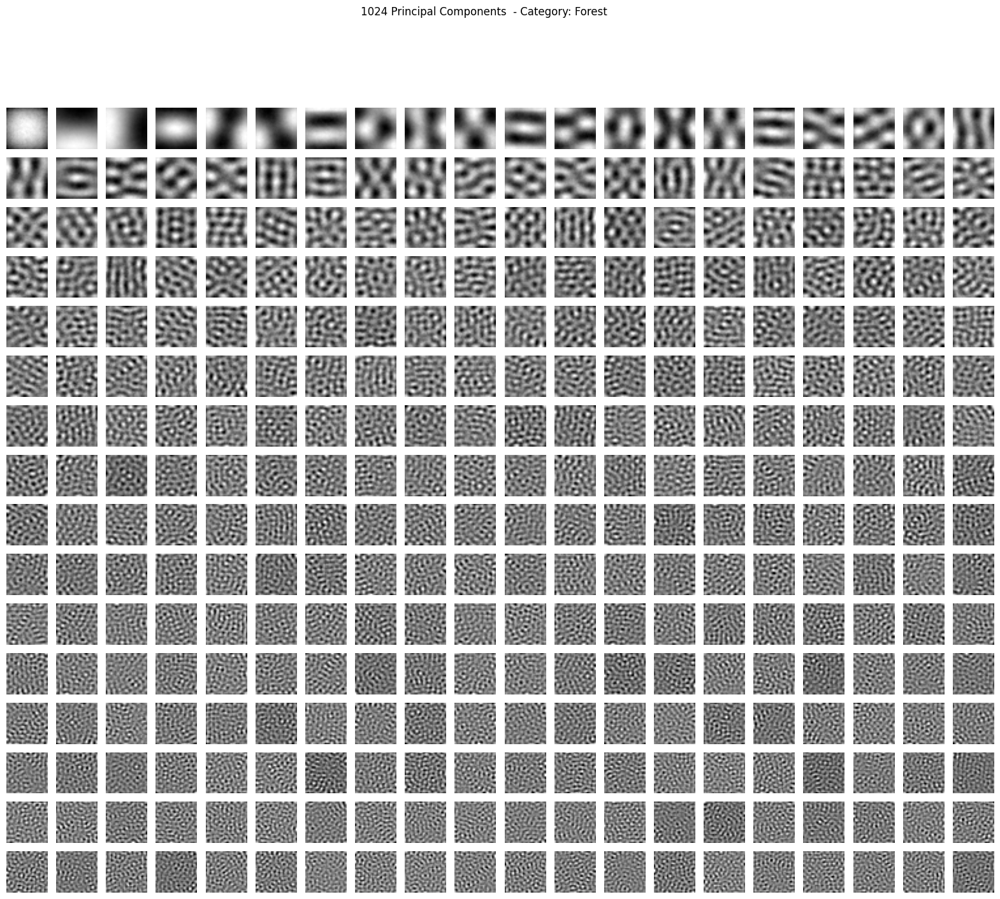

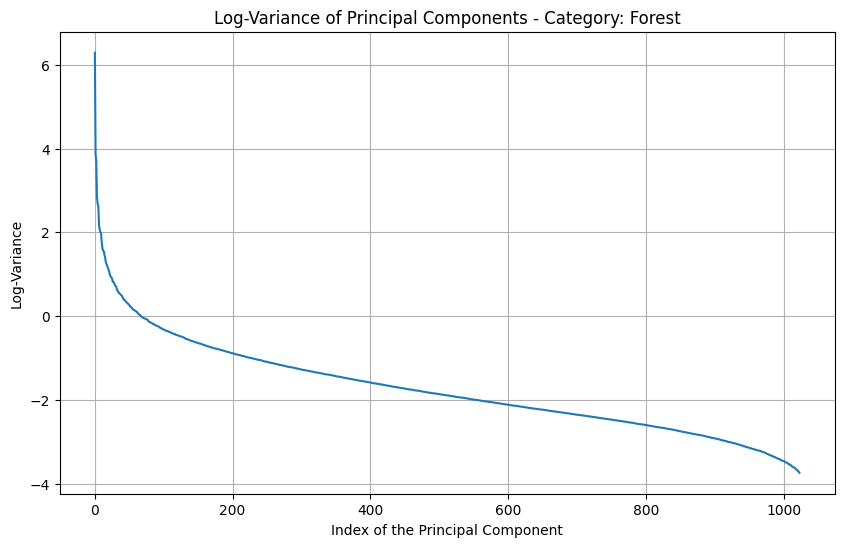

Category: Forest
Number of components that explain 95% of variance: 458
[[-0.72334029 -0.7396225  -0.75451125 ... -0.82489514 -0.83887595
  -0.82662786]
 [-0.02162562  0.31410083  0.18939416 ...  0.5234598   0.46678299
   0.64288239]
 [-0.81567116 -0.79508162 -0.7360033  ... -0.89777919 -0.94768086
  -0.98990678]
 ...
 [ 0.95708167  0.94263754  0.94822007 ...  1.5073945  -0.25858309
  -0.86291207]
 [-1.18499467 -1.27572734 -1.36527357 ... -1.26219945 -1.2740956
  -1.29832251]
 [ 0.12610378  0.11075071  0.09685441 ...  1.28874234  1.30095398
   1.33228226]]


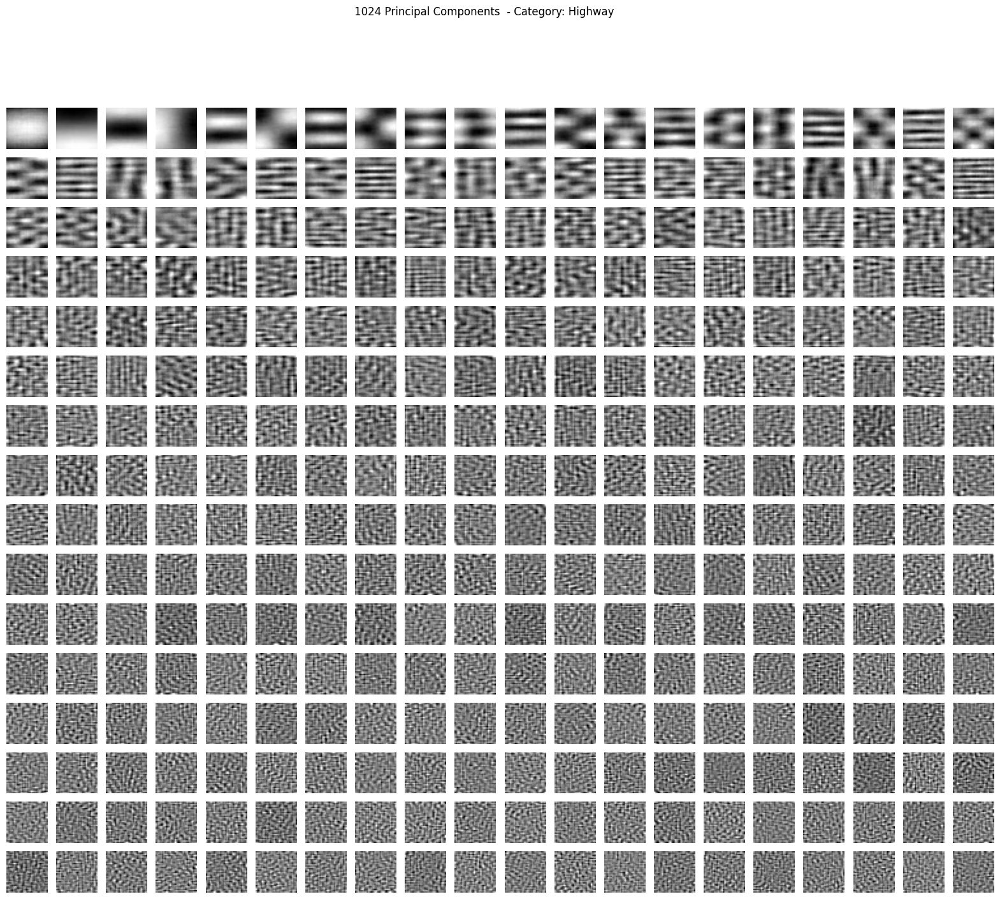

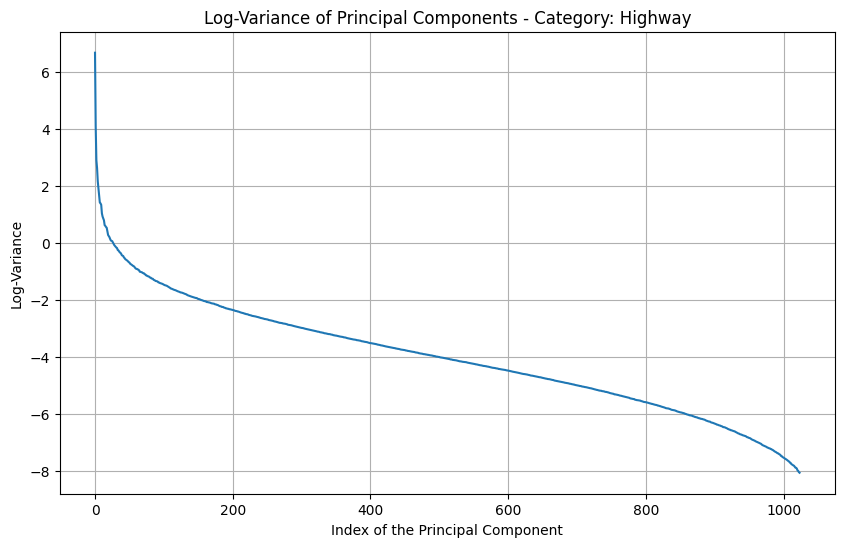

Category: Highway
Number of components that explain 95% of variance: 46
[[-0.10249361 -1.2121324  -1.44768282 ... -0.05317084  1.58304325
   1.41825834]
 [-0.18177831  1.38538552  1.27588303 ... -0.42904897 -0.42647592
  -0.32320283]
 [-1.65647384 -1.52890288 -1.73270715 ... -1.2788604  -1.4720794
  -1.42393772]
 ...
 [-0.05492278  0.14998065  0.10411633 ... -0.23293864 -0.18141261
  -0.04391189]
 [-0.38791855 -0.38852916 -0.38675891 ... -0.90298227 -0.63886413
  -0.45463387]
 [-0.97462537 -1.02207012 -1.02014632 ... -0.2656237  -0.21408772
  -0.01105413]]


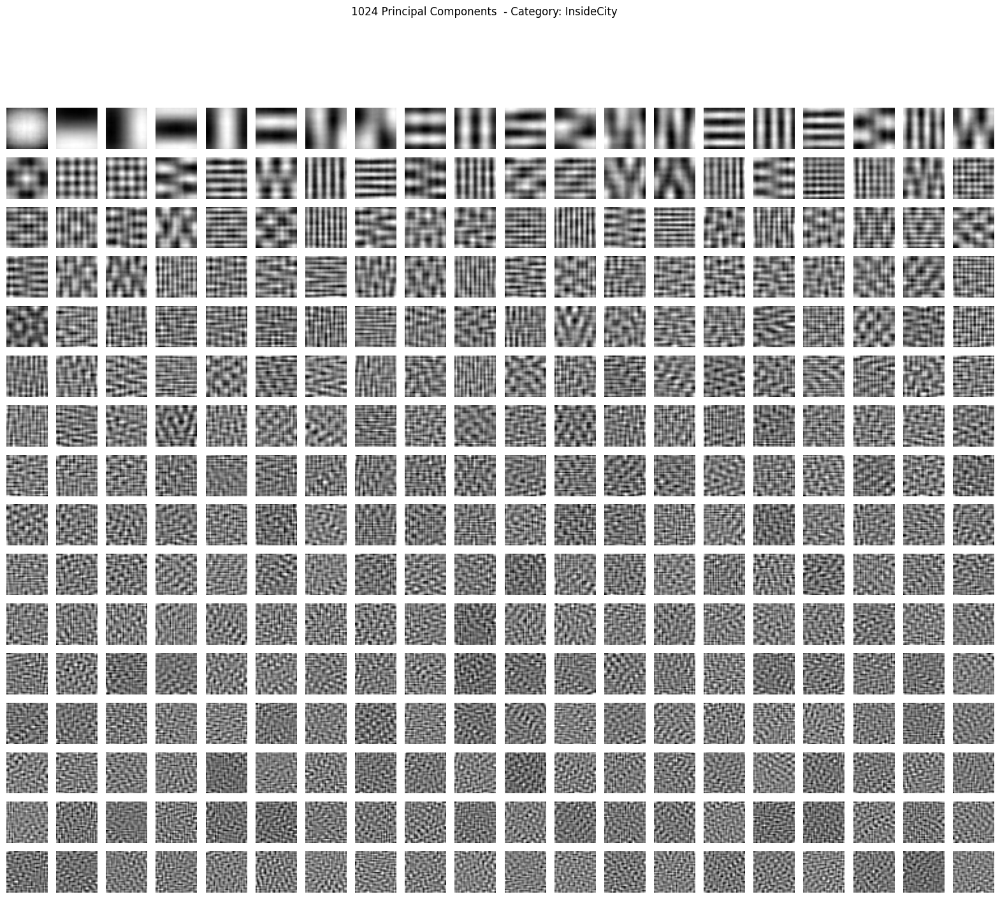

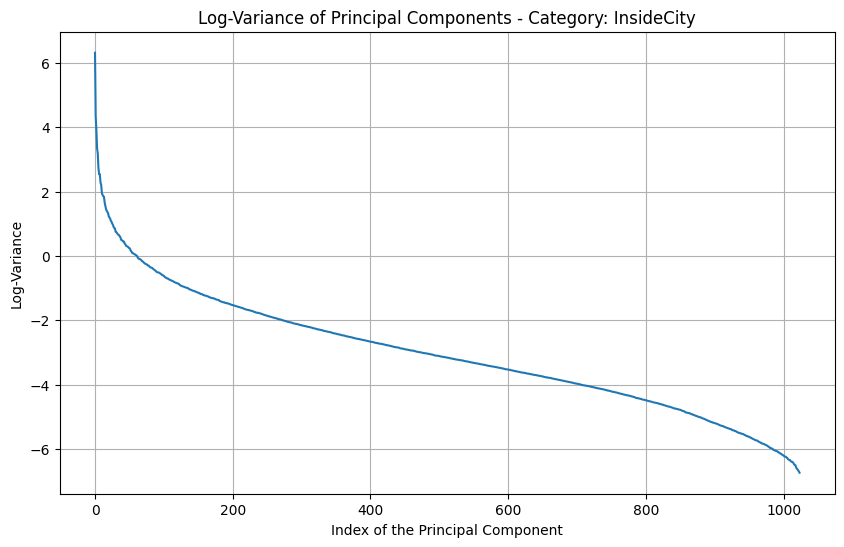

Category: InsideCity
Number of components that explain 95% of variance: 155
[[ 0.89102151  0.81366868  0.81162404 ... -1.30593752 -0.42161
   1.60513797]
 [ 1.01248887  0.61531875  0.26289263 ...  0.31982761  0.21895807
   0.02808278]
 [ 1.5439086   1.8359337  -0.45350672 ... -0.2469529  -0.48119773
  -0.37361995]
 ...
 [ 0.83028783  1.16459548  1.1469599  ...  1.19982892  1.17236172
   0.42978552]
 [ 0.38996863 -0.05601947 -0.01147308 ... -0.14254596 -0.39181614
  -0.2694748 ]
 [-0.55140345 -0.57478082 -0.57544703 ...  0.09609846  0.11467955
   0.13222794]]


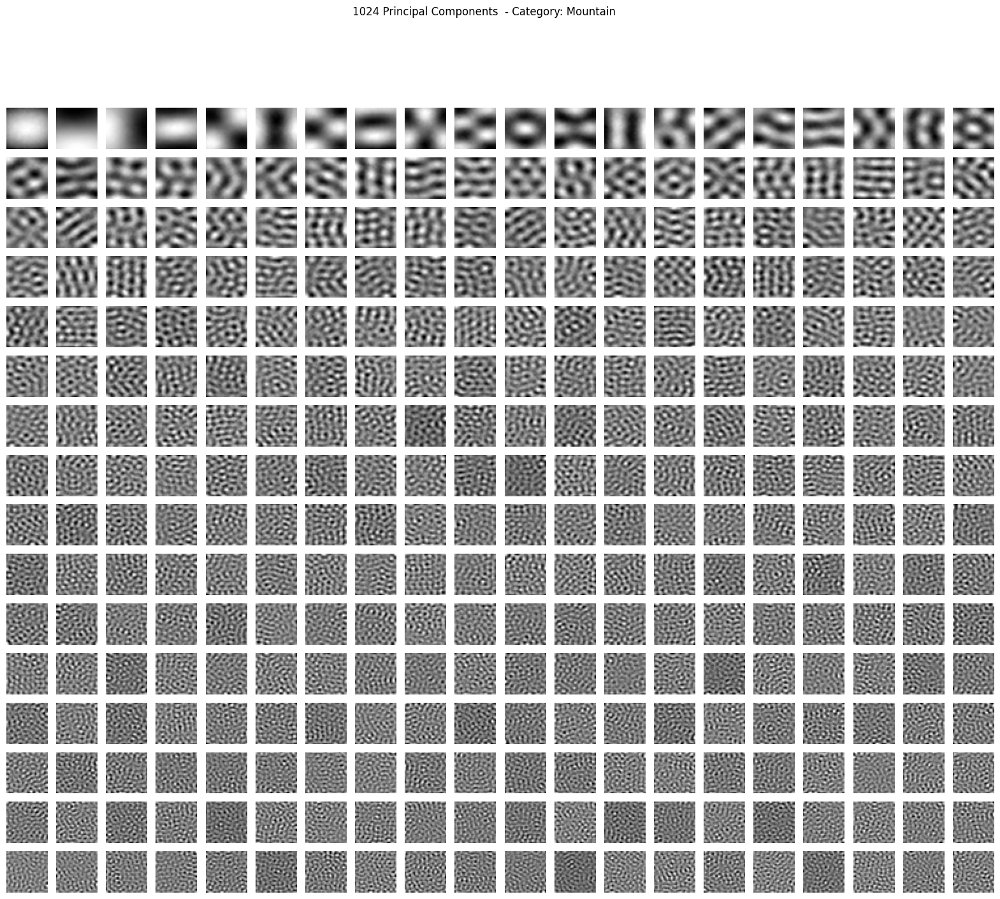

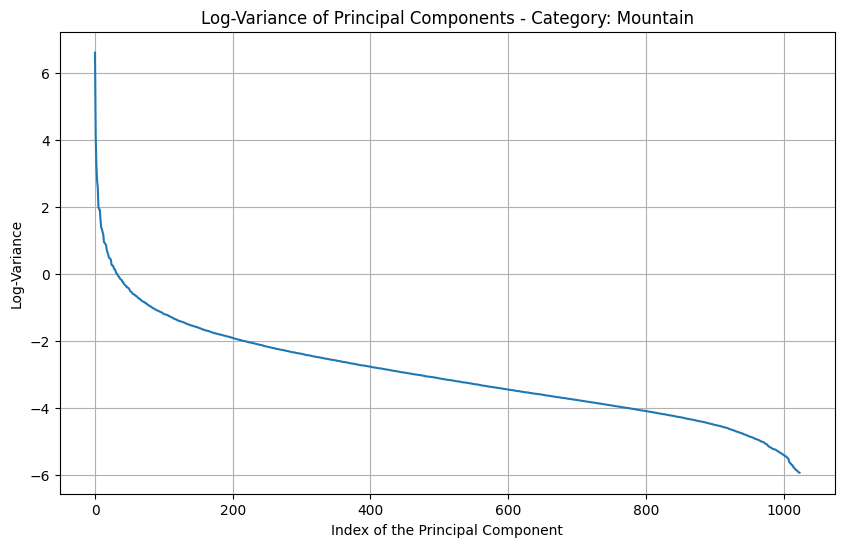

Category: Mountain
Number of components that explain 95% of variance: 117
[[ 0.00903089  0.42036004  1.32359588 ... -1.47040952 -1.02484757
  -0.71249943]
 [-0.35109143 -0.56205471 -0.11950942 ...  0.52288466  0.81885888
   0.42511629]
 [-0.92401331 -0.90589987 -0.3162965  ...  0.73704024  0.60485724
   0.45809066]
 ...
 [ 0.17272286  0.61684299  0.04447982 ...  0.19341455  0.27562395
   0.44160348]
 [-0.12192268 -0.36557176  0.17567121 ...  0.3252026   0.20977729
   0.37565474]
 [-0.13829188 -0.11996807 -0.10311049 ...  0.40757012  0.40731726
   0.40862911]]


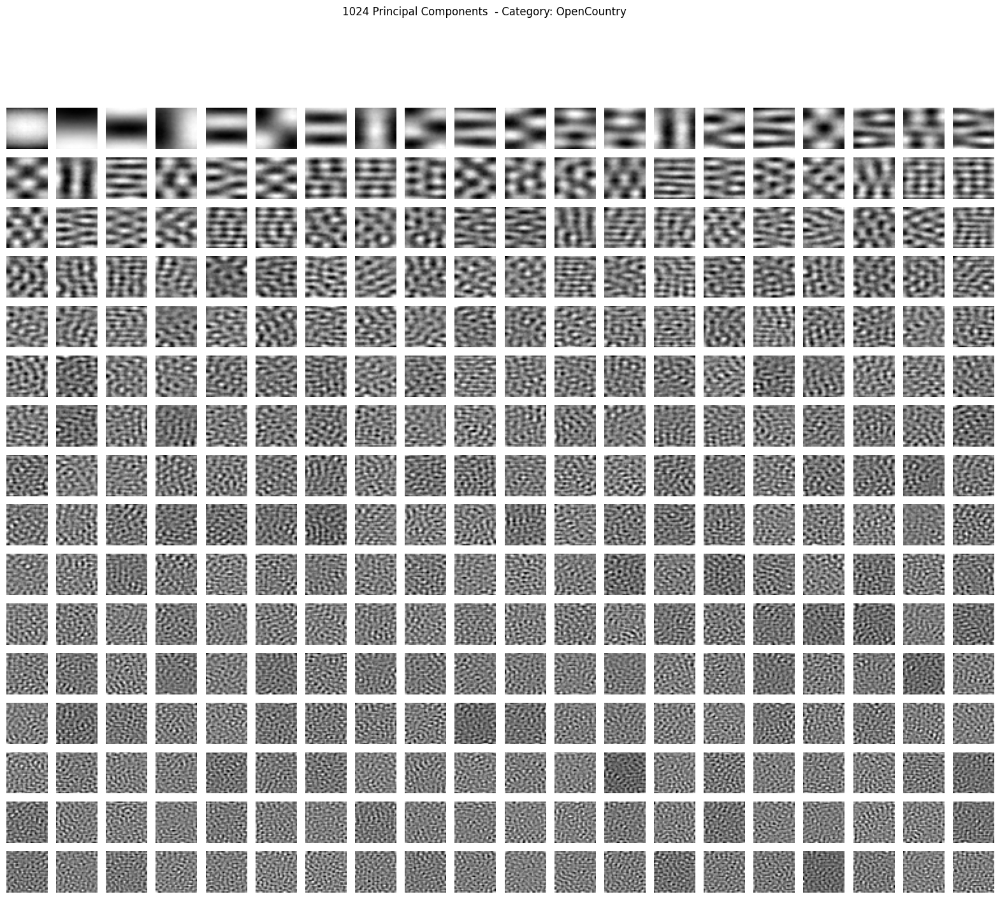

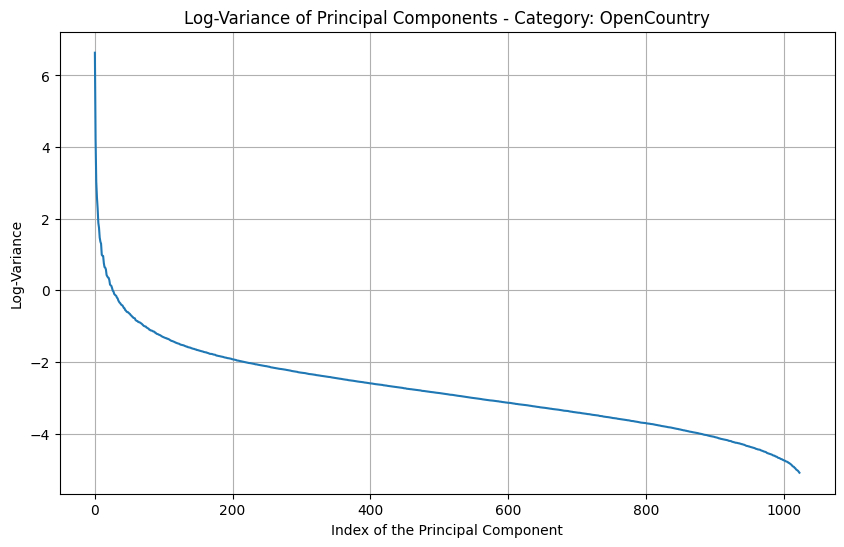

Category: OpenCountry
Number of components that explain 95% of variance: 148
[[-1.40664058e-01 -1.46816567e-01 -1.60931097e-01 ... -2.62177627e-01
  -2.60601905e-01 -2.56556715e-01]
 [ 4.57306814e-02  9.72542496e-02  2.83852591e-01 ... -7.39398491e-01
  -1.52683353e-01  2.52489537e-01]
 [-1.16215459e-02 -3.19597124e-02 -4.61482099e-02 ... -9.28411916e-02
  -7.55986726e-02 -1.33151563e-01]
 ...
 [ 4.32858216e-01  8.28971427e-02  4.27331201e-01 ... -6.16244720e-01
   3.40658600e-01 -1.64002851e-01]
 [-3.27058797e-01 -3.33458957e-01  1.15907211e+00 ...  1.49183584e-02
   1.48600743e-03 -7.34751679e-01]
 [-1.48844140e+00 -1.13745694e+00 -1.35180355e+00 ... -8.31763820e-01
  -8.77279345e-01 -8.11879899e-01]]


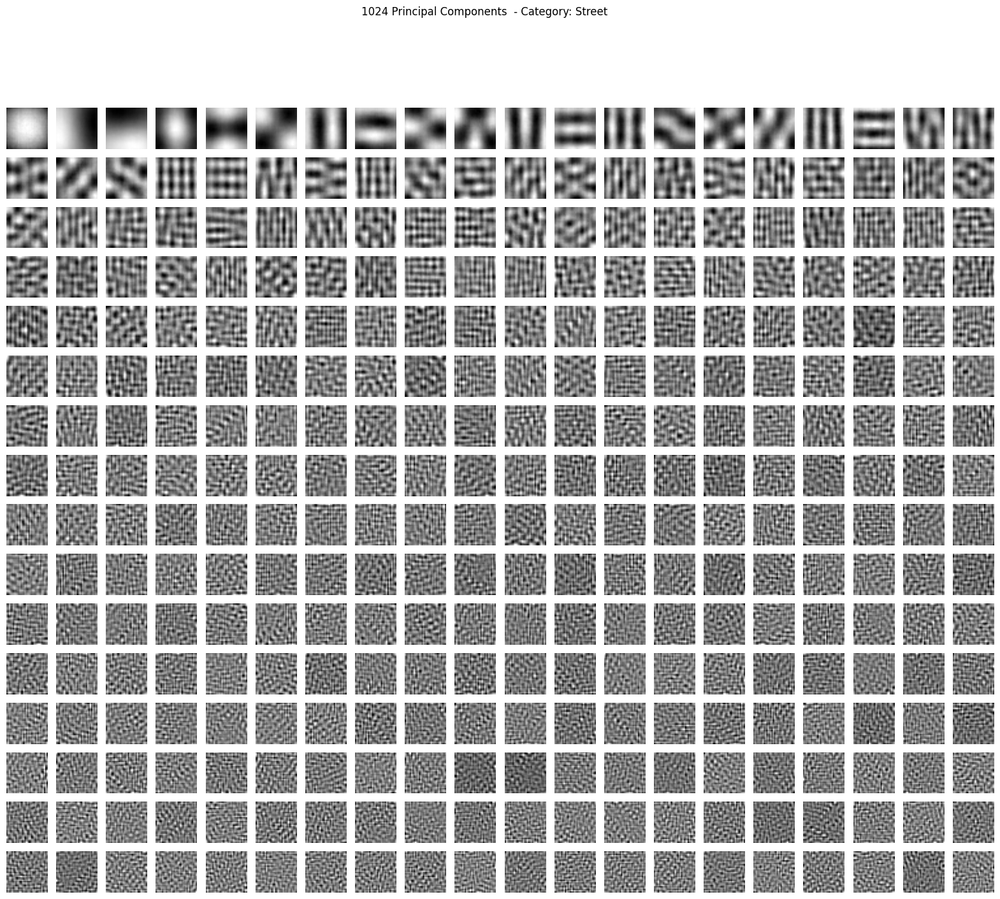

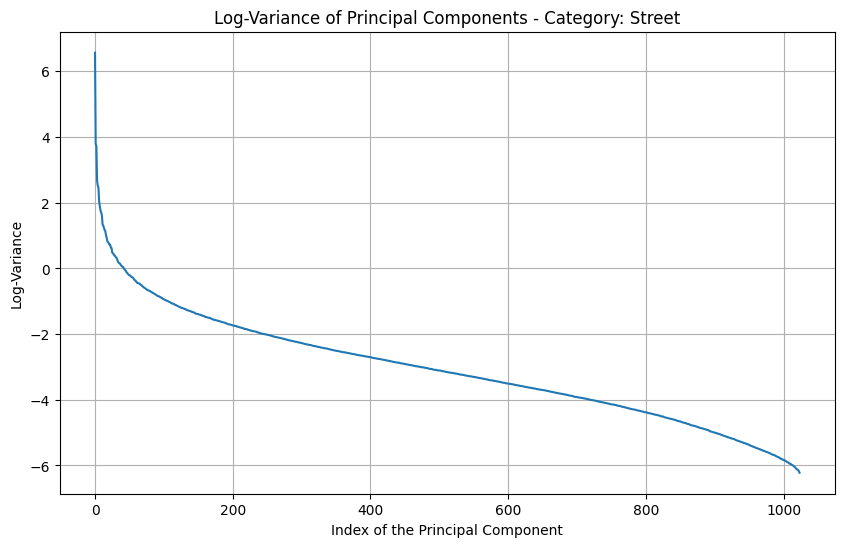

Category: Street
Number of components that explain 95% of variance: 135
[[-0.48241541 -0.13787713 -1.0597327  ... -0.64127788 -0.67098931
  -0.79229171]
 [-0.76702726 -0.80288417 -0.91670884 ... -0.23135539 -0.13582498
  -0.33616865]
 [-1.03582733 -1.13538768 -1.0597327  ... -0.97236913 -0.93857148
  -0.87093362]
 ...
 [ 0.7509026   0.74879893  0.75190285 ...  0.85651583  0.85580305
   0.85918836]
 [-0.90933318 -0.89788517 -0.5829865  ...  0.68308709  0.68266165
   0.68617616]
 [ 0.38723191  0.2896274   0.16391587 ...  0.63578834  0.33637885
  -0.96530391]]


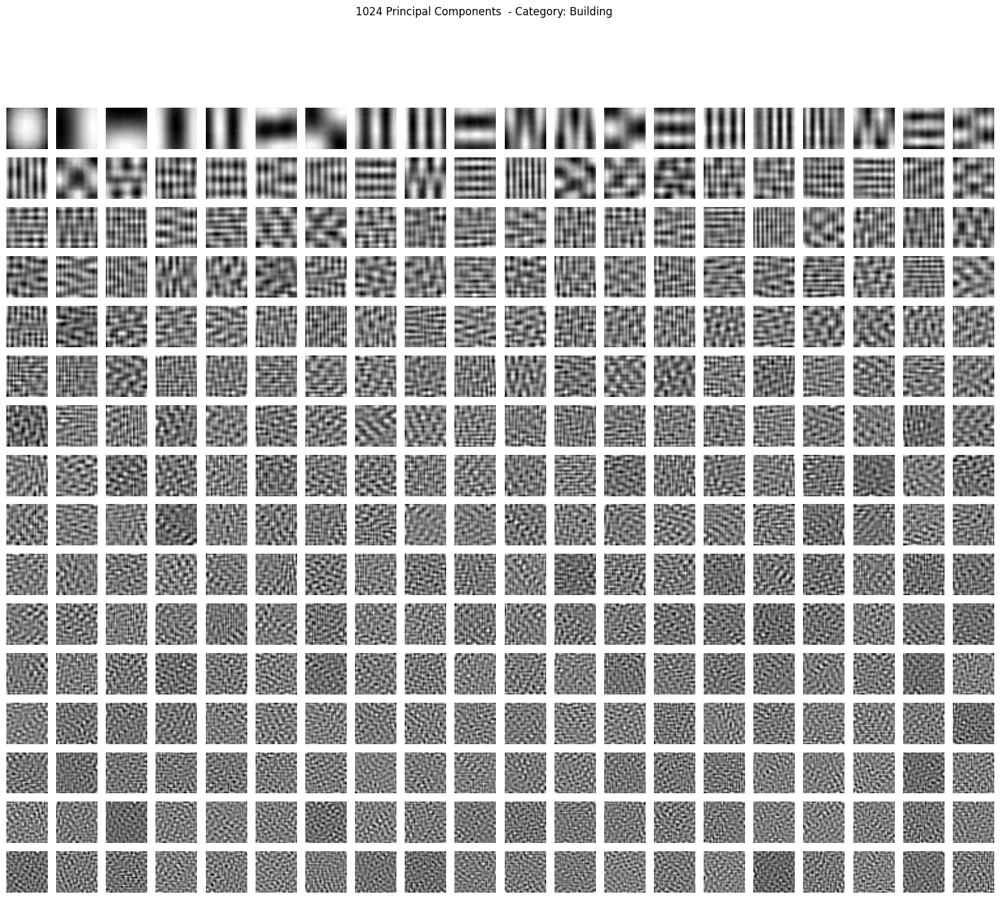

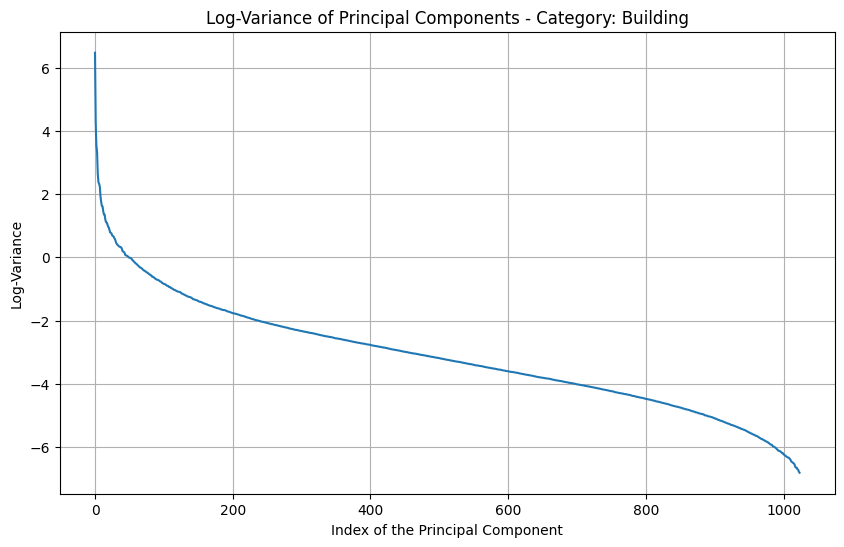

Category: Building
Number of components that explain 95% of variance: 127
[[-1.48145083 -1.44946122 -1.41715243 ... -0.79069814 -0.61739163
  -0.67726779]
 [-1.06269197 -1.01520074 -1.02979375 ... -0.80513929 -0.73294449
  -0.73515224]
 [-0.50434683 -0.50339375 -0.50298594 ... -0.7473747  -0.73294449
  -0.73515224]
 ...
 [-0.31823178 -0.28626351 -0.25507639 ...  0.37903476  0.37925176
   0.37912347]
 [ 1.57393787  1.52832491  1.46479616 ...  2.08309011  2.09810051
   2.10118594]
 [ 0.17807502  0.17901557  0.17876534 ...  0.27794674  0.27814301
   0.27782568]]


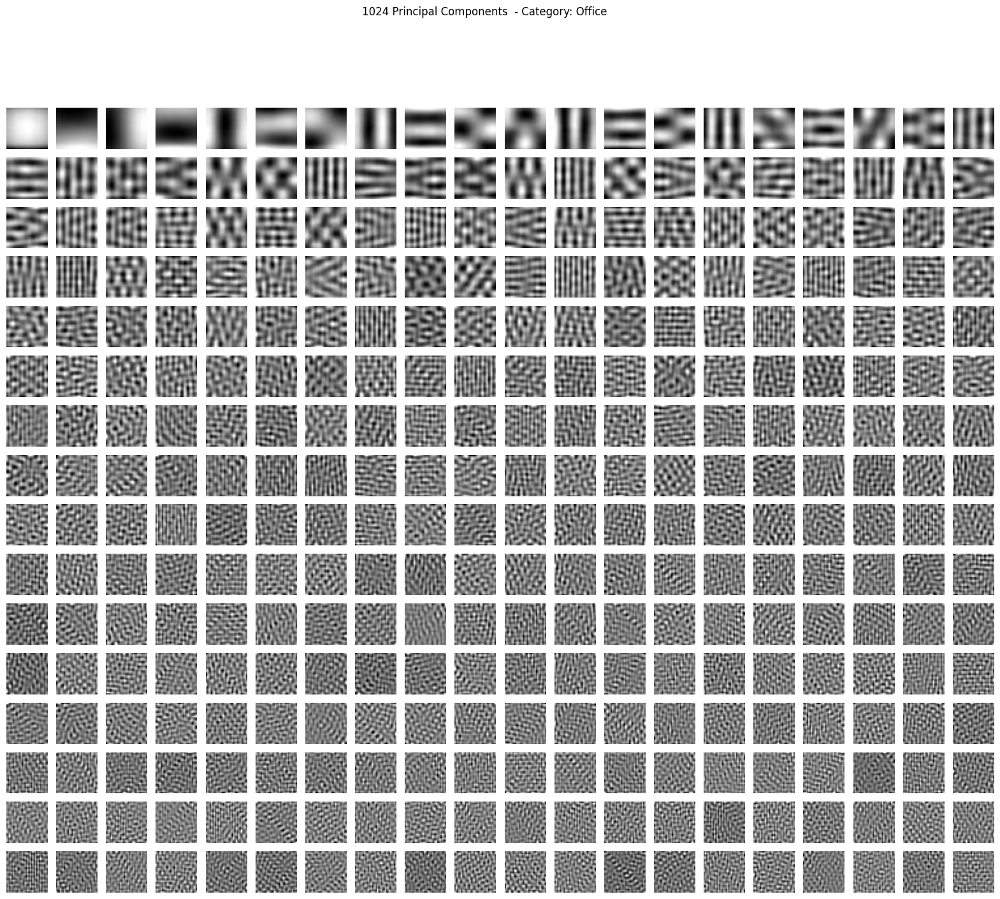

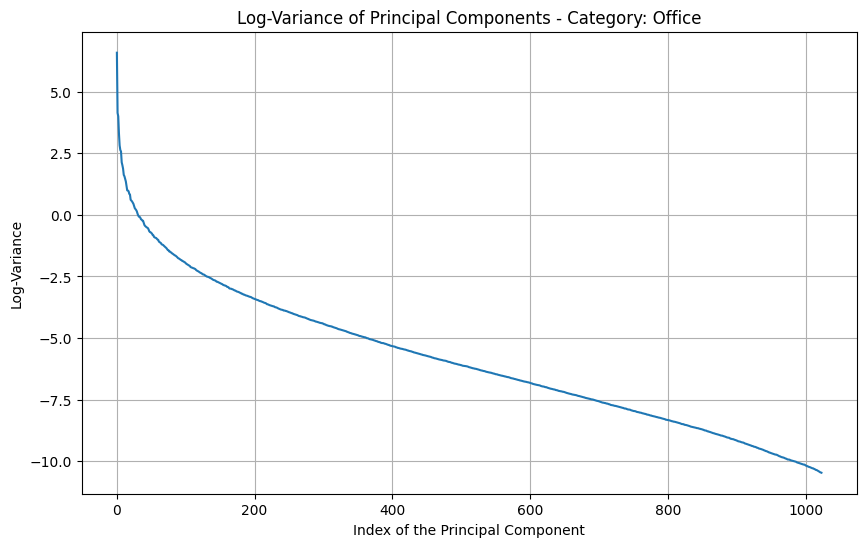

Category: Office
Number of components that explain 95% of variance: 22
[[ 0.9743665   0.99749685  1.02326716 ...  1.98278079  2.06189863
   2.18102659]
 [ 1.63624518  1.6452425   1.6850467  ...  1.05290241  1.22757085
   1.46122391]
 [-1.05854658 -1.3565056  -1.07236804 ...  0.7162223   0.73018314
   0.70943001]
 ...
 [ 0.28096979  0.28655651  0.298461   ...  0.31541265  0.4253326
   0.43750455]
 [-0.12876463 -0.14000769 -0.1269687  ...  0.31541265  0.34510877
   0.19757033]
 [ 0.28096979  0.28655651  0.28270435 ...  0.29938027  0.29697448
   0.29354402]]


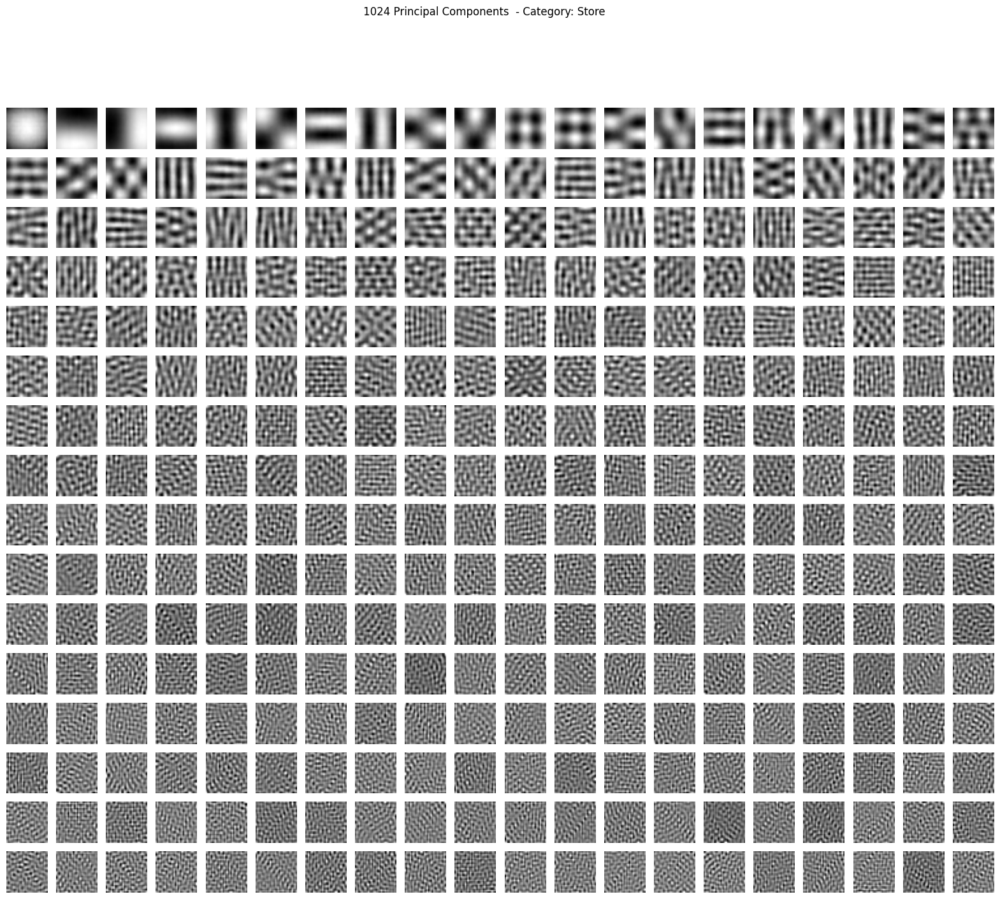

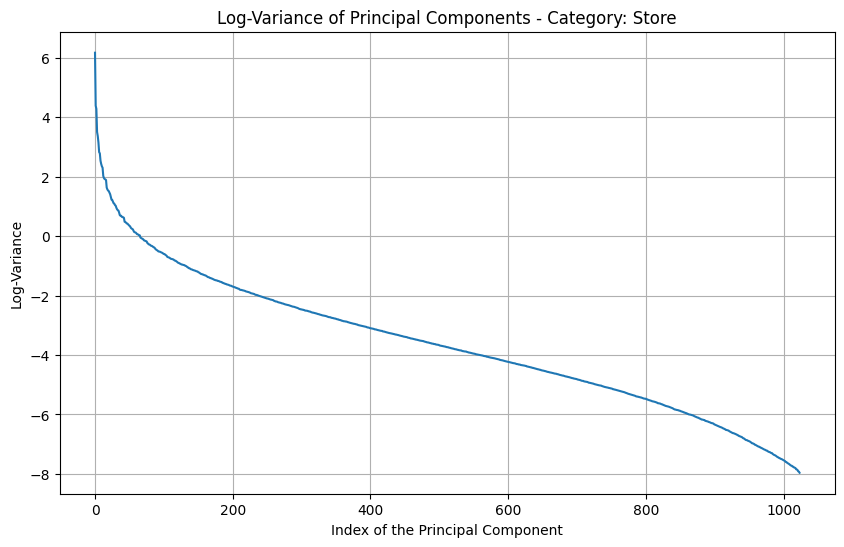

Category: Store
Number of components that explain 95% of variance: 115
{'Bedroom': PCA(n_components=27), 'Suburb': PCA(n_components=30), 'Industry': PCA(n_components=49), 'Kitchen': PCA(n_components=40), 'LivingRoom': PCA(n_components=31), 'Coast': PCA(n_components=23), 'Forest': PCA(n_components=458), 'Highway': PCA(n_components=46), 'InsideCity': PCA(n_components=155), 'Mountain': PCA(n_components=117), 'OpenCountry': PCA(n_components=148), 'Street': PCA(n_components=135), 'Building': PCA(n_components=127), 'Office': PCA(n_components=22), 'Store': PCA(n_components=115)}


In [9]:
pca_by_category, nummin_components_95_dict, min_components = apply_pca_and_visualize(normalized_patches_by_category)
print(pca_by_category)

In [10]:
def compute_residuals_with_pca(patches_by_category, pca_by_category):
    residuals = {}
    for category, patches in patches_by_category.items():
        if patches.size == 0:
            continue  # Pular se não houver patches para esta categoria

        # Normalizar patches
        #patches = normalize_patches(patches)

        # Obter PCA da categoria
        pca = pca_by_category[category] #usar o pc com minimo de dimensoes

        # Projetar dados nos componentes principais
        projected_data = pca.transform(patches)
        # Reconstruir dados a partir da projeção
        reconstructed_data = pca.inverse_transform(projected_data)
        # Calcular os resíduos
        residuals[category] = patches - reconstructed_data
    return residuals


residuals_by_category = compute_residuals_with_pca(normalized_patches_by_category, pca_by_category)


In [11]:
# Função para calcular a métrica OOD para uma imagem individual
def calculate_ood_for_image(image, pca, residuals_by_category):
    #print(f'image: {image}')
    image = image.reshape(1, -1) 
    projected_data = pca.transform(image)
    reconstructed_data = pca.inverse_transform(projected_data)
    residual = image - reconstructed_data

    
    norm_residual = np.linalg.norm(residual)
    #print("NORM RESIDUAL: " + str(norm_residual))
    norm_image = np.linalg.norm(image)
    #print("NORM IMAGE: " + str(norm_image))
    
    ood_metric = norm_residual / (norm_image)
    return ood_metric

# Calcular a métrica OOD para cada patch do Bedroom
def calculate_ood_for_patches(patches, pca, residuals_by_category):
    ood_metrics = []
    for patch in patches:
        #print(patch)
        ood_metric = calculate_ood_for_image(patch, pca, residuals_by_category)
        ood_metrics.append(ood_metric)
    return np.array(ood_metrics)

In [12]:
test_patches_by_category = load_patches_by_category('patches_test', y, patch_size)

In [13]:
target_patches_environment = test_patches_by_category['Bedroom']
target_environment = 'Bedroom'
target_normalized_patches= normalize_patches(target_patches_environment)
#target_environment_pca = pca_by_category[test_environment]

ood_metrics = {}
ood_mean = {}

for category in test_patches_by_category:
	test_patches_environment = test_patches_by_category[category]
	test_normalized_patches= normalized_patches_by_category[category]
	test_pca = pca_by_category[category]
	test_environment_residuals = residuals_by_category[category]

	# Calcular a métrica OOD para cada patch do Bedroom usando PCA do Bedroom
	ood_metrics[category]= calculate_ood_for_patches(target_normalized_patches, test_pca, test_environment_residuals)
	mean_ood = np.mean(ood_metrics[category])

	print(f"OOD[{category}] = {mean_ood}")
	ood_mean[category] = mean_ood


	# Visualizar a distribuição dos valores de OOD para Bedroom usando PCA do Bedroom
	plt.figure(figsize=(10, 6))
	plt.hist(ood_metrics[category], bins=50, alpha=0.75)
	plt.title(f"Distribuição da métrica OOD para {target_environment} (usando PCA do {category})")
	plt.xlabel("OOD")
	plt.ylabel("Frequência")
	plt.grid(True)
	plt.show()



ValueError: X has 6225920 features, but PCA is expecting 1024 features as input.

: 

In [ ]:
# Function to compute residuals with PCA
def compute_residuals_with_pca(patches, pca):
    projected_data = pca.transform(patches)
    reconstructed_data = pca.inverse_transform(projected_data)
    residuals = patches - reconstructed_data
    return residuals, reconstructed_data

In [ ]:
from collections import Counter

# Categorize test images
def categorize_test_images(test_patches, pca_by_category, scalers_by_category):
    categories = list(pca_by_category.keys())
    predictions = []
    for test_patch in test_patches:
        min_error = float('inf')
        best_category = None
        for category in categories:
            scaler = scalers_by_category[category]
            test_patch_normalized = scaler.transform(test_patch.reshape(1, -1))
            residuals = compute_residuals_with_pca(test_patch_normalized, pca_by_category[category])
            reconstruction_error = np.linalg.norm(residuals)
            if reconstruction_error < min_error:
                min_error = reconstruction_error
                best_category = category
        predictions.append(best_category)
    return predictions

def determine_final_category(predictions):
    category_count = Counter(predictions)
    final_category = category_count.most_common(1)[0][0]
    return final_category

In [ ]:
# Categorize test images and print results
for test_category, test_patches in test_patches_by_category.items():
    predictions = categorize_test_images(test_patches, pca_by_category, scalers_by_category)
    final_category = determine_final_category(predictions)
    print(f"Test category: {test_category}")
    print(f"Predictions: {predictions}")
    print(f"Final category: {final_category}")


In [ ]:
print(ood_mean)

min_ood_category = min(ood_metrics, key=lambda k: np.mean(ood_metrics[k]))
min_ood_value = np.mean(ood_metrics[min_ood_category])

print(f"Estamos no ambiente {min_ood_category} com OOD: {min_ood_value}")


{'Bedroom': 0.2313014, 'Suburb': 0.22605962, 'Industry': 0.18464527, 'Kitchen': 0.20026414, 'LivingRoom': 0.21915342, 'Coast': 0.2726642, 'Forest': 0.051902004, 'Highway': 0.21007445, 'InsideCity': 0.1110163, 'Mountain': 0.13972272, 'OpenCountry': 0.12725684, 'Street': 0.115934074, 'Building': 0.12145487, 'Office': 0.2508728, 'Store': 0.12413089}
Estamos no ambiente Forest com OOD: 0.05190200358629227


: 